In [1]:
!pip install torch==2.2
!pip install torch_geometric==2.4.0
!pip install seaborn==0.12.2
!pip install networkx==2.8.5
!pip install scikit-learn==1.3.2
!pip install matplotlib==3.5.2
!pip install pandas==1.4.3

  Using cached matplotlib-3.5.2.tar.gz (35.2 MB)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [699 lines of output]
      /private/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/pip-install-83ekzime/matplotlib_64412ef4ff9d4409aaf7c064ef0a81a6/setup.py:70: SetuptoolsDeprecationWarning: The test command is disabled and references to it are deprecated.
      !!
      
              ********************************************************************************
              Please remove any references to `setuptools.command.test` in all supported versions of the affected package.
      
              This deprecation is overdue, please update your project and remove deprecated
              calls to avoid build errors in the future.
              ********************************************************************************
      
      !!
        class NoopTestComman

In [2]:
import os
import torch
import pandas as pd
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

import torch
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import GATConv
from torch_geometric.utils import to_networkx
from torch_geometric.datasets import Planetoid

In [3]:
def visualize(data, labels):
    tsne = TSNE(n_components=2, init='pca', random_state=7)
    tsne_res = tsne.fit_transform(data)
    v = pd.DataFrame(data,columns=[str(i) for i in range(data.shape[1])])
    v['color'] = labels
    v['label'] = v['color'].apply(lambda i: str(i))
    v["dim1"] = tsne_res[:,0]
    v["dim2"] = tsne_res[:,1]
    
    plt.figure(figsize=(12,12))

    sns.scatterplot(
        x="dim1", y="dim2",
        hue="color",
        palette=sns.color_palette(["#52D1DC", "#8D0004", "#845218","#563EAA", "#E44658", "#63C100", "#FF7800"]),
        legend=False,
        data=v,
    )

In [174]:
def visualize_graph(G, color):
    plt.figure(figsize=(75,75))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.arf_layout(G), with_labels=False,
                     node_color=color, cmap="rainbow")
    plt.show()

In [144]:
'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Grays', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_grey', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gist_yerg', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'grey', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'

('Accent',
 'Accent_r',
 'Blues',
 'Blues_r',
 'BrBG',
 'BrBG_r',
 'BuGn',
 'BuGn_r',
 'BuPu',
 'BuPu_r',
 'CMRmap',
 'CMRmap_r',
 'Dark2',
 'Dark2_r',
 'GnBu',
 'GnBu_r',
 'Grays',
 'Greens',
 'Greens_r',
 'Greys',
 'Greys_r',
 'OrRd',
 'OrRd_r',
 'Oranges',
 'Oranges_r',
 'PRGn',
 'PRGn_r',
 'Paired',
 'Paired_r',
 'Pastel1',
 'Pastel1_r',
 'Pastel2',
 'Pastel2_r',
 'PiYG',
 'PiYG_r',
 'PuBu',
 'PuBuGn',
 'PuBuGn_r',
 'PuBu_r',
 'PuOr',
 'PuOr_r',
 'PuRd',
 'PuRd_r',
 'Purples',
 'Purples_r',
 'RdBu',
 'RdBu_r',
 'RdGy',
 'RdGy_r',
 'RdPu',
 'RdPu_r',
 'RdYlBu',
 'RdYlBu_r',
 'RdYlGn',
 'RdYlGn_r',
 'Reds',
 'Reds_r',
 'Set1',
 'Set1_r',
 'Set2',
 'Set2_r',
 'Set3',
 'Set3_r',
 'Spectral',
 'Spectral_r',
 'Wistia',
 'Wistia_r',
 'YlGn',
 'YlGnBu',
 'YlGnBu_r',
 'YlGn_r',
 'YlOrBr',
 'YlOrBr_r',
 'YlOrRd',
 'YlOrRd_r',
 'afmhot',
 'afmhot_r',
 'autumn',
 'autumn_r',
 'binary',
 'binary_r',
 'bone',
 'bone_r',
 'brg',
 'brg_r',
 'bwr',
 'bwr_r',
 'cividis',
 'cividis_r',
 'cool',
 'coo

In [6]:
from torch_geometric.datasets import EllipticBitcoinDataset

In [7]:
dataset = EllipticBitcoinDataset(root='data/EllipticBitcoinDataset')

In [8]:
print(f'Dataset: {dataset}:')
print('======================')
print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')

Dataset: EllipticBitcoinDataset():
Number of graphs: 1
Number of features: 165
Number of classes: 2


In [72]:
data = dataset[0]

In [10]:
print(data)
print('==============================================================')

# Gather some statistics about the graph.
print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(f'Average node degree: {data.num_edges / data.num_nodes:.2f}')
print(f'Number of training nodes: {data.train_mask.sum()}')
print(f'Training node label rate: {int(data.train_mask.sum()) / data.num_nodes:.2f}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')
print(f'Has self-loops: {data.has_self_loops()}')
print(f'Is undirected: {data.is_undirected()}')

Data(x=[203769, 165], edge_index=[2, 234355], y=[203769], train_mask=[203769], test_mask=[203769])
Number of nodes: 203769
Number of edges: 234355
Average node degree: 1.15
Number of training nodes: 29894
Training node label rate: 0.15
Has isolated nodes: False
Has self-loops: False
Is undirected: False


In [74]:
data.train_mask.sum() + data.test_mask.sum()

tensor(46564)

In [86]:
data.y[data.train_mask].sum() + data.y[data.test_mask].sum()

tensor(4545)

In [116]:
# Ensure `train_mask` exists and is a Boolean tensor
train_mask = data.train_mask.bool()

# Determine the number of training nodes
train_indices = train_mask.nonzero(as_tuple=True)[0]

# Shuffle the training indices for random splitting
train_indices = train_indices[torch.randperm(train_indices.size(0))]

# Define the size of the validation set (e.g., 20% of the training nodes)
val_size = int(0.2 * len(train_indices))

# Split the training indices into validation and new training sets
val_indices = train_indices[:val_size]
new_train_indices = train_indices[val_size:]

# Create new masks for training and validation
new_train_mask = torch.zeros_like(train_mask)
new_val_mask = torch.zeros_like(train_mask)

new_train_mask[new_train_indices] = True
new_val_mask[val_indices] = True

# Update the data object with the new masks
data.train_mask = new_train_mask
data.val_mask = new_val_mask

# Verify the sizes of the new masks
print("Training nodes:", new_train_mask.sum().item())
print("Validation nodes:", new_val_mask.sum().item())
print("Testing nodes:", data.test_mask.sum().item())

Training nodes: 23916
Validation nodes: 5978
Testing nodes: 16670


In [130]:
data.subgraph(subset=val_indices)

Data(x=[5978, 165], edge_index=[2, 901], y=[5978], train_mask=[5978], test_mask=[5978], val_mask=[5978])

In [394]:
def visualize_graph(G, color):
    plt.figure(figsize=(60,60))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.random_layout(G), with_labels=False,
                     node_color=color, cmap="winter_r", arrows=True)
    plt.savefig('foo.svg')
    plt.show()

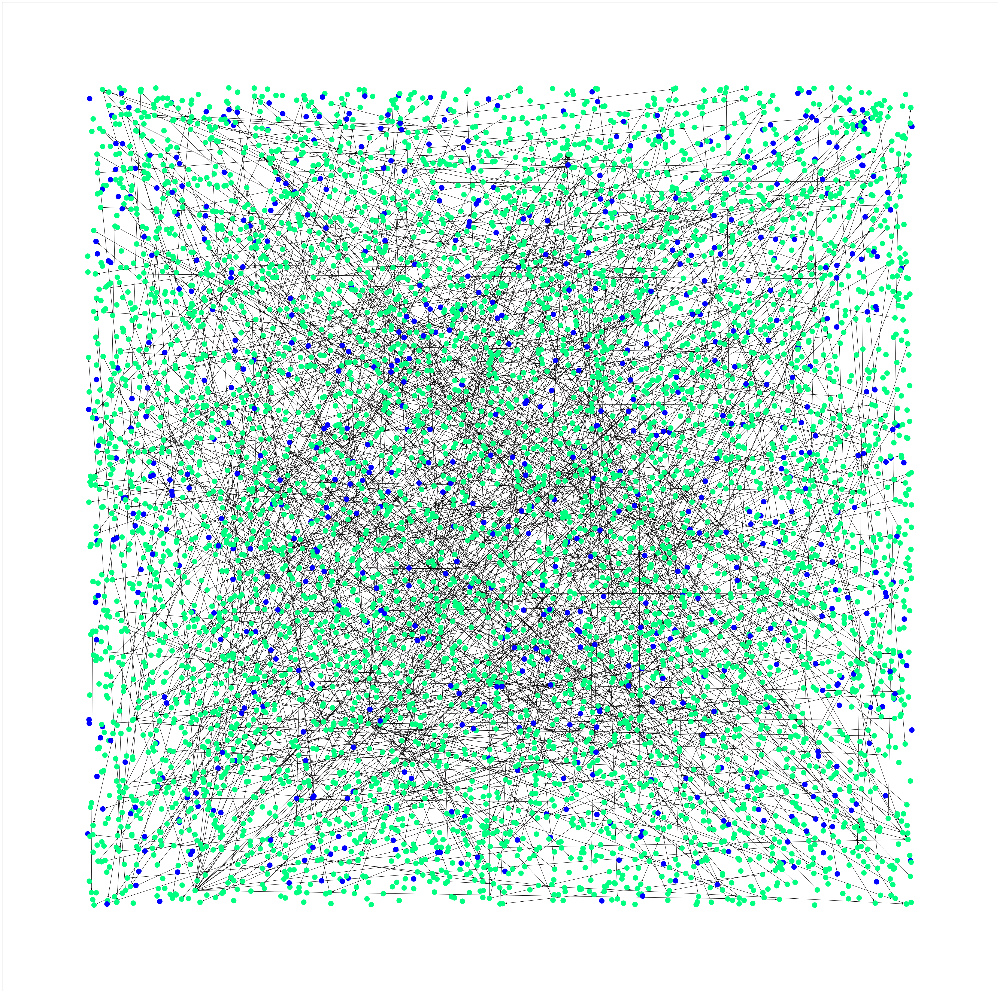

In [396]:
G = to_networkx(data.subgraph(subset=val_indices))
visualize_graph(G, color=data.subgraph(subset=val_indices).y)

In [12]:
NUM_EPOCHS = 1000
LR = 0.01
WDECAY = 1e-4

In [13]:
class MLP(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(12345)
        self.lin1 = Linear(dataset.num_features, hidden_channels)
        self.lin2 = Linear(hidden_channels, dataset.num_classes)

    def forward(self, x):
        x = self.lin1(x)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.lin2(x)
        return x

model = MLP(hidden_channels=8)
print(model)

MLP(
  (lin1): Linear(in_features=165, out_features=8, bias=True)
  (lin2): Linear(in_features=8, out_features=2, bias=True)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


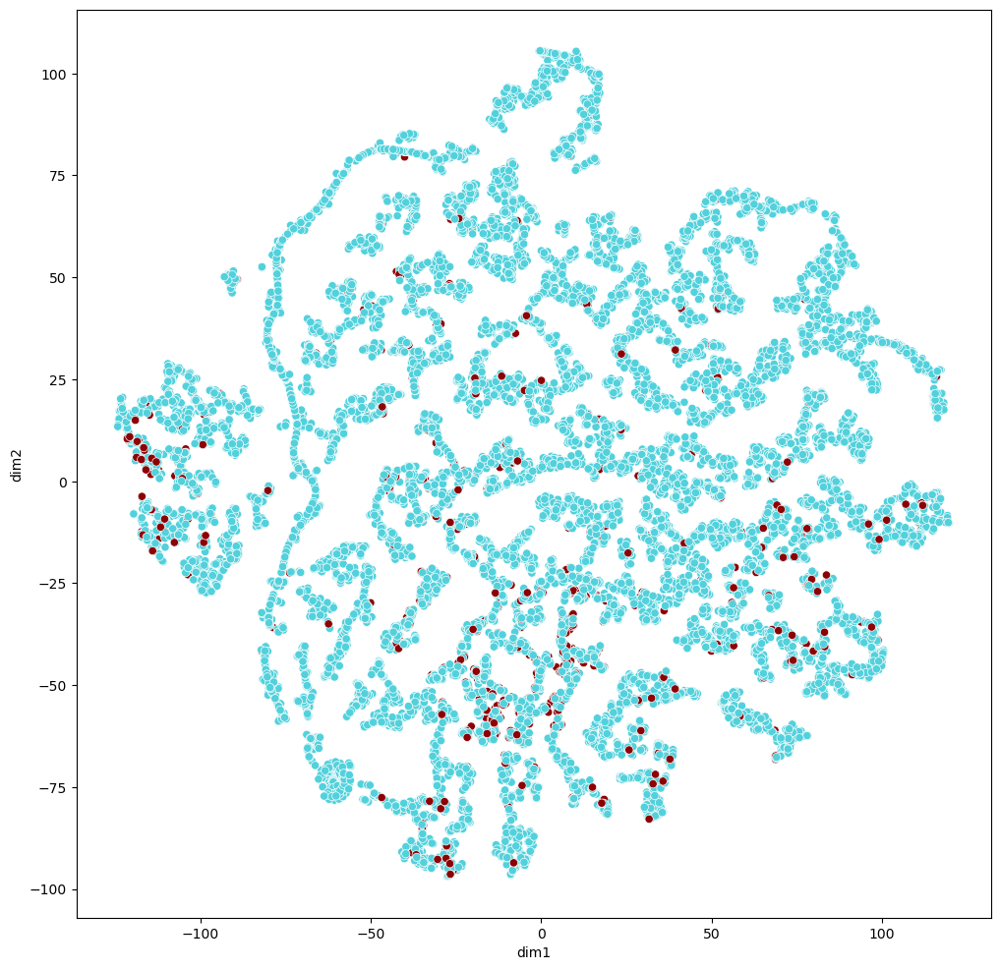

In [14]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

In [15]:
model = MLP(hidden_channels=8)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)  # Define optimizer.

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc

losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 0.8353, Acc: 0.7143
Epoch: 001, Loss: 0.6491, Acc: 0.8170
Epoch: 002, Loss: 0.5637, Acc: 0.8466
Epoch: 003, Loss: 0.5138, Acc: 0.8615
Epoch: 004, Loss: 0.4801, Acc: 0.8730
Epoch: 005, Loss: 0.4555, Acc: 0.8792
Epoch: 006, Loss: 0.4317, Acc: 0.8849
Epoch: 007, Loss: 0.4106, Acc: 0.8918
Epoch: 008, Loss: 0.3989, Acc: 0.8976
Epoch: 009, Loss: 0.3804, Acc: 0.9040
Epoch: 010, Loss: 0.3675, Acc: 0.9102
Epoch: 011, Loss: 0.3533, Acc: 0.9152
Epoch: 012, Loss: 0.3425, Acc: 0.9224
Epoch: 013, Loss: 0.3341, Acc: 0.9249
Epoch: 014, Loss: 0.3220, Acc: 0.9279
Epoch: 015, Loss: 0.3188, Acc: 0.9307
Epoch: 016, Loss: 0.3109, Acc: 0.9328
Epoch: 017, Loss: 0.3014, Acc: 0.9341
Epoch: 018, Loss: 0.2934, Acc: 0.9363
Epoch: 019, Loss: 0.2927, Acc: 0.9379
Epoch: 020, Loss: 0.2877, Acc: 0.9398
Epoch: 021, Loss: 0.2807, Acc: 0.9415
Epoch: 022, Loss: 0.2807, Acc: 0.9420
Epoch: 023, Loss: 0.2814, Acc: 0.9436
Epoch: 024, Loss: 0.2745, Acc: 0.9446
Epoch: 025, Loss: 0.2692, Acc: 0.9455
Epoch: 026, 

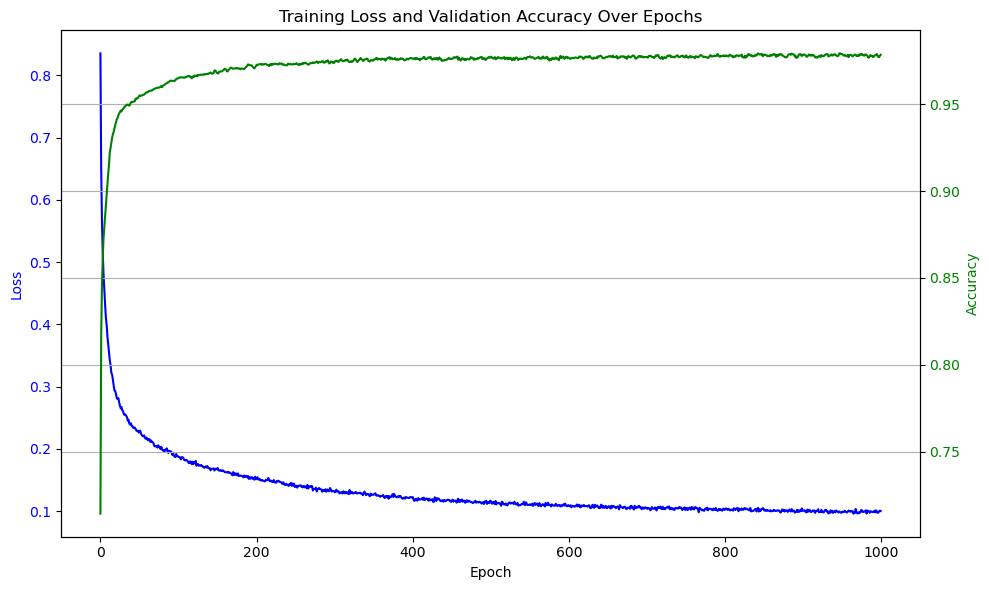

In [16]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [17]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9269


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


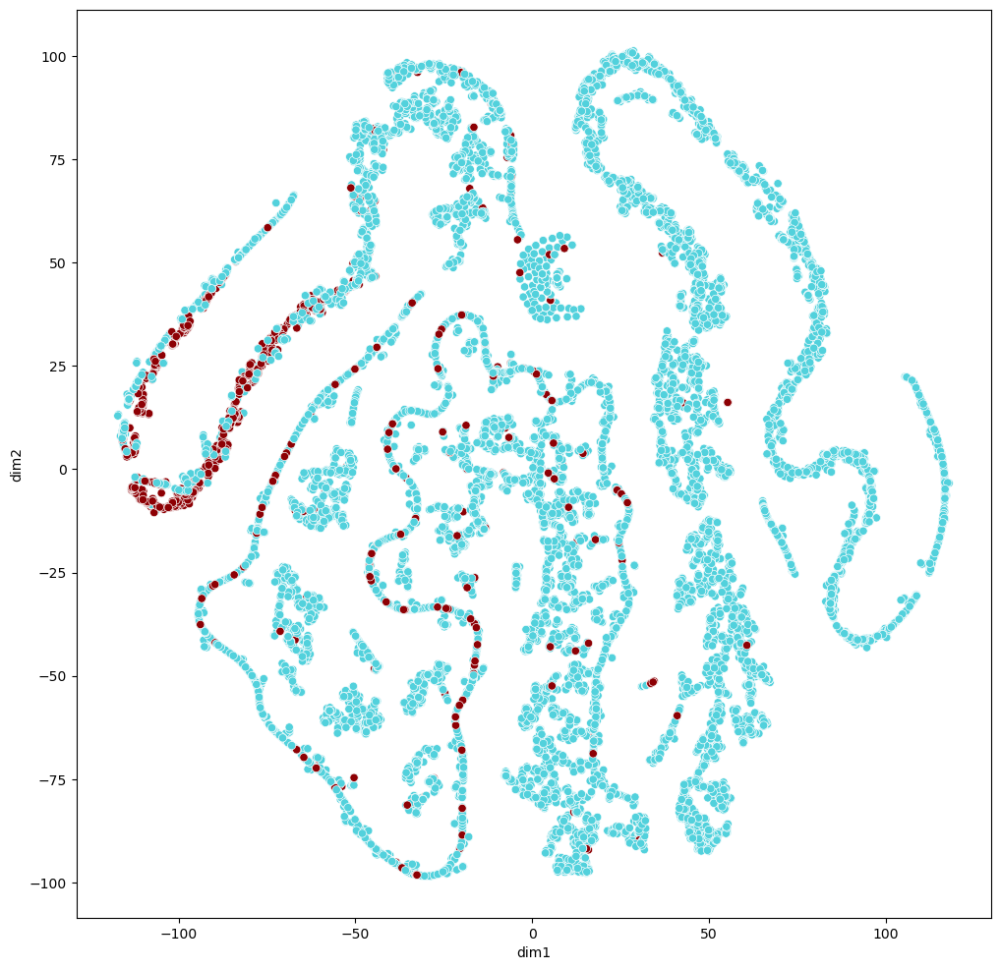

In [18]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

# ========================================

In [20]:
class GCN(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GCNConv(dataset.num_features, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, dataset.num_classes)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GCN(hidden_channels=8)
print(model)

GCN(
  (conv1): GCNConv(165, 8)
  (conv2): GCNConv(8, 2)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


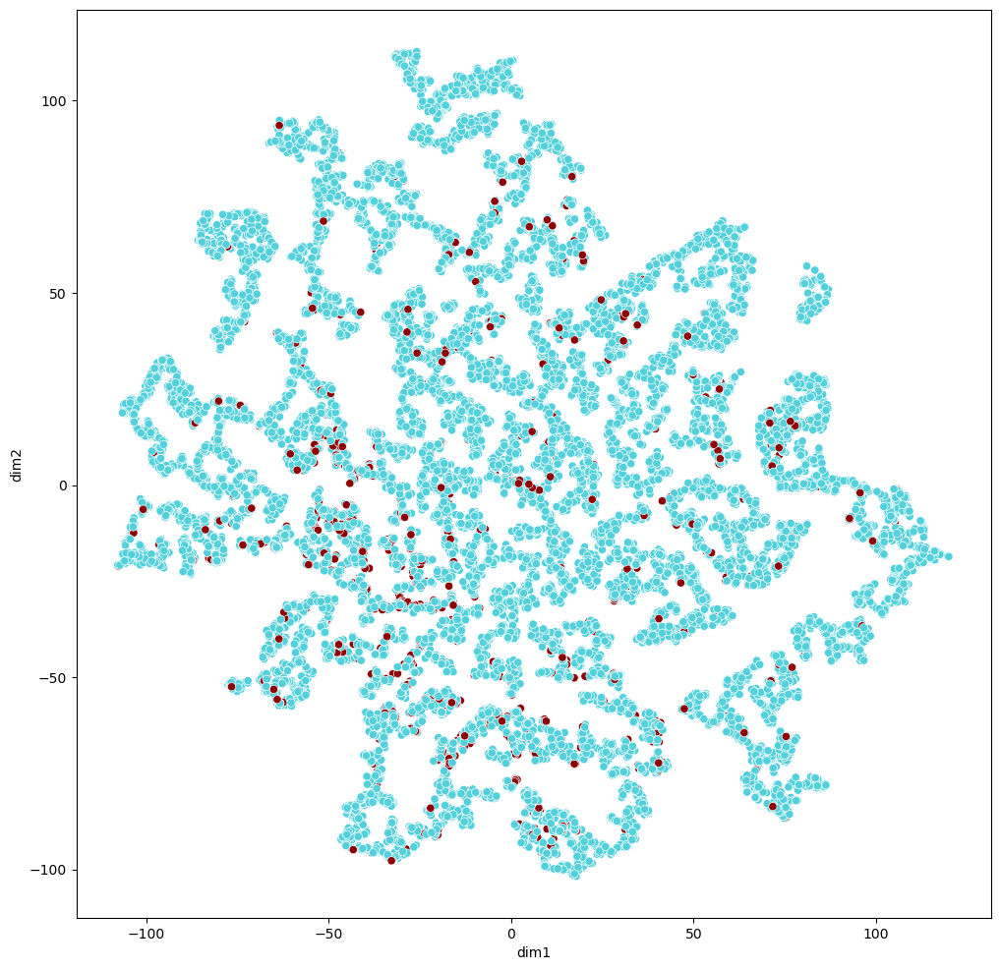

In [21]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [22]:
model = GCN(hidden_channels=8)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x, data.edge_index)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 1.0906, Acc: 0.7909
Epoch: 001, Loss: 0.5855, Acc: 0.8297
Epoch: 002, Loss: 0.4584, Acc: 0.8536
Epoch: 003, Loss: 0.4058, Acc: 0.8697
Epoch: 004, Loss: 0.3685, Acc: 0.8762
Epoch: 005, Loss: 0.3543, Acc: 0.8796
Epoch: 006, Loss: 0.3365, Acc: 0.8829
Epoch: 007, Loss: 0.3235, Acc: 0.8862
Epoch: 008, Loss: 0.3166, Acc: 0.8873
Epoch: 009, Loss: 0.3111, Acc: 0.8914
Epoch: 010, Loss: 0.3072, Acc: 0.8938
Epoch: 011, Loss: 0.3061, Acc: 0.8961
Epoch: 012, Loss: 0.2972, Acc: 0.8983
Epoch: 013, Loss: 0.3084, Acc: 0.8988
Epoch: 014, Loss: 0.3011, Acc: 0.9008
Epoch: 015, Loss: 0.2951, Acc: 0.9008
Epoch: 016, Loss: 0.2914, Acc: 0.9018
Epoch: 017, Loss: 0.2893, Acc: 0.9035
Epoch: 018, Loss: 0.2845, Acc: 0.9041
Epoch: 019, Loss: 0.2838, Acc: 0.9055
Epoch: 020, Loss: 0.2758, Acc: 0.9060
Epoch: 021, Loss: 0.2771, Acc: 0.9057
Epoch: 022, Loss: 0.2757, Acc: 0.9050
Epoch: 023, Loss: 0.2715, Acc: 0.9053
Epoch: 024, Loss: 0.2732, Acc: 0.9057
Epoch: 025, Loss: 0.2654, Acc: 0.9063
Epoch: 026, 

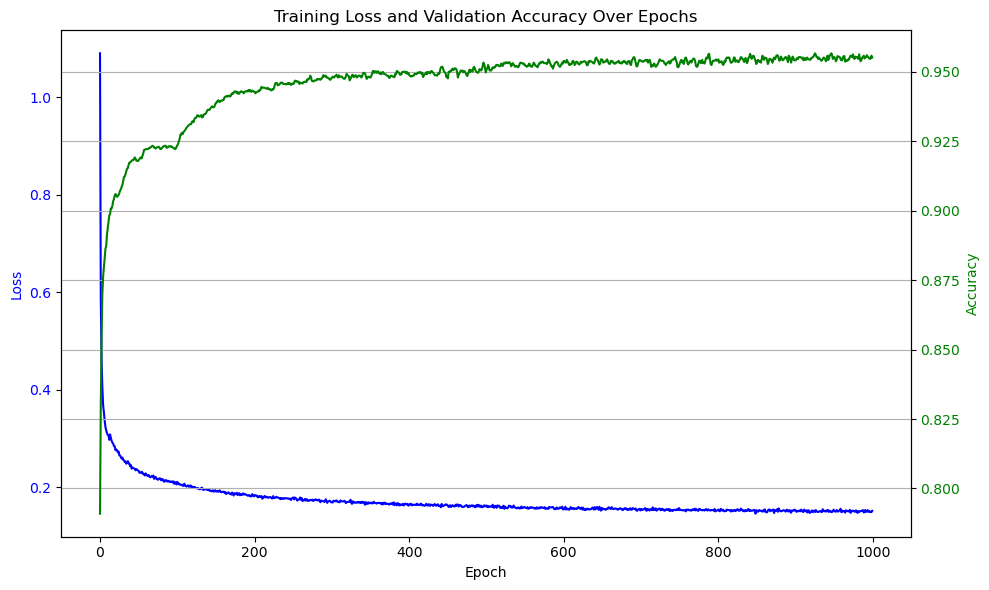

In [23]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [24]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9391


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


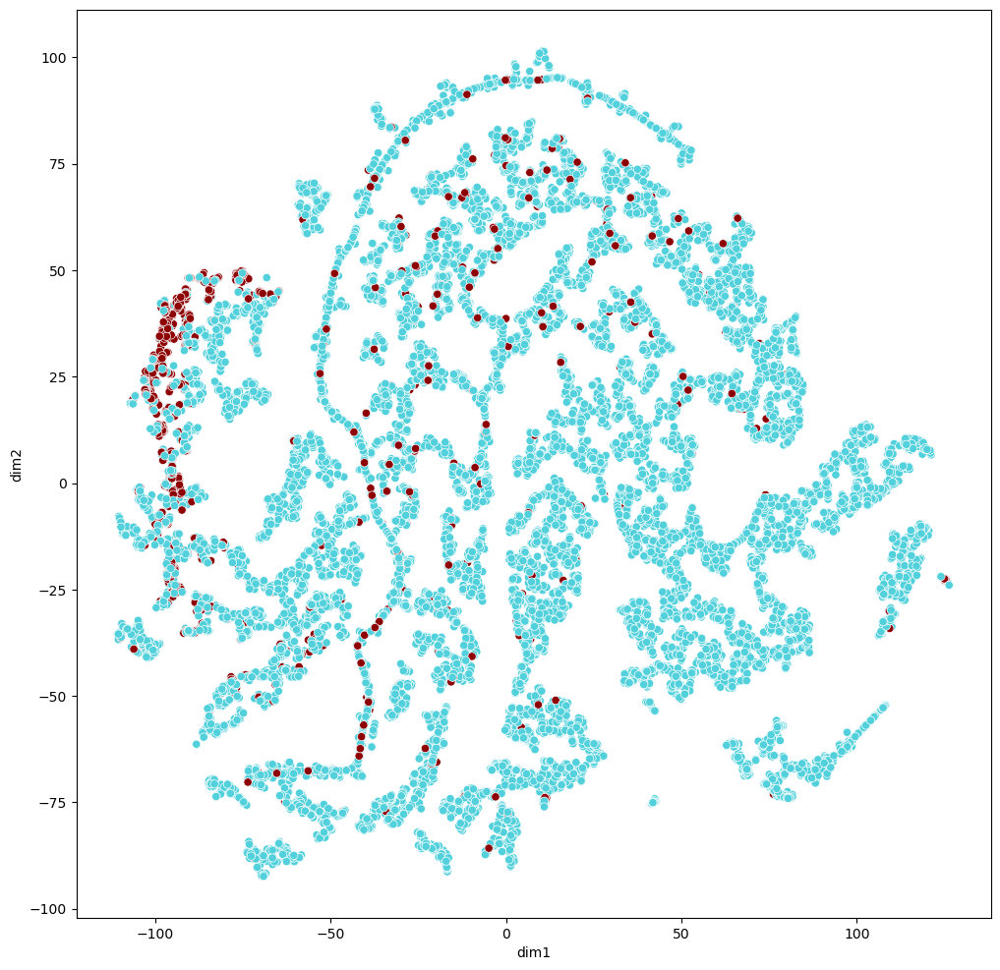

In [25]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)
# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

# ========================================

In [27]:
class GAT(torch.nn.Module):
    def __init__(self, hidden_channels, heads):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GATConv(dataset.num_features, hidden_channels, heads)
        self.conv2 = GATConv(hidden_channels * heads, dataset.num_classes, heads=1)

    def forward(self, x, edge_index):
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GAT(hidden_channels=8, heads=4)
print(model)

GAT(
  (conv1): GATConv(165, 8, heads=4)
  (conv2): GATConv(32, 2, heads=1)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


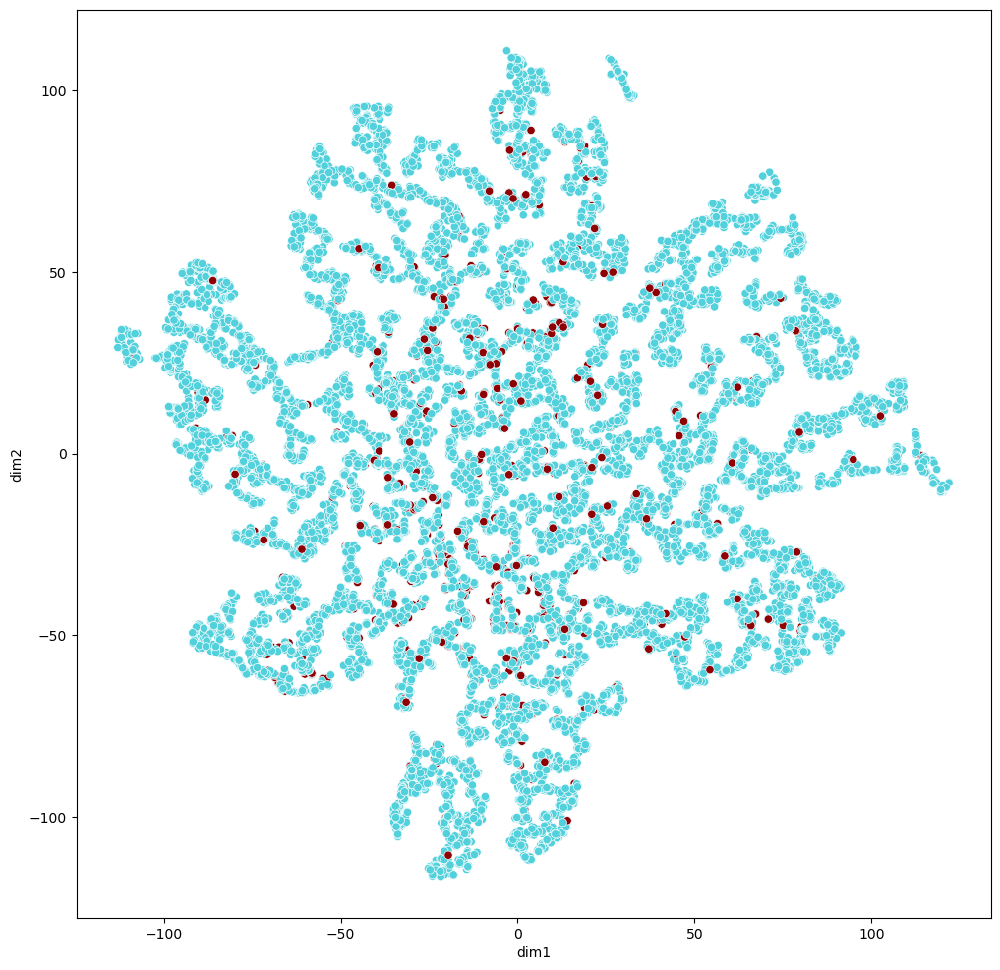

In [28]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [29]:
model = GAT(hidden_channels=8, heads=4)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
      model.eval()
      out = model(data.x, data.edge_index)
      pred = out.argmax(dim=1)  # Use the class with highest probability.
      correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
      acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
      return acc


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f}')

Epoch: 000, Loss: 1.6516, Acc: 0.8091
Epoch: 001, Loss: 0.9357, Acc: 0.8663
Epoch: 002, Loss: 0.4806, Acc: 0.8856
Epoch: 003, Loss: 0.5199, Acc: 0.8911
Epoch: 004, Loss: 0.3851, Acc: 0.8926
Epoch: 005, Loss: 0.3772, Acc: 0.8936
Epoch: 006, Loss: 0.3573, Acc: 0.8949
Epoch: 007, Loss: 0.3640, Acc: 0.8993
Epoch: 008, Loss: 0.3634, Acc: 0.9033
Epoch: 009, Loss: 0.3547, Acc: 0.9090
Epoch: 010, Loss: 0.3601, Acc: 0.9118
Epoch: 011, Loss: 0.3577, Acc: 0.9125
Epoch: 012, Loss: 0.3364, Acc: 0.9139
Epoch: 013, Loss: 0.3199, Acc: 0.9159
Epoch: 014, Loss: 0.3143, Acc: 0.9177
Epoch: 015, Loss: 0.3068, Acc: 0.9184
Epoch: 016, Loss: 0.2954, Acc: 0.9202
Epoch: 017, Loss: 0.2895, Acc: 0.9214
Epoch: 018, Loss: 0.2832, Acc: 0.9234
Epoch: 019, Loss: 0.2747, Acc: 0.9241
Epoch: 020, Loss: 0.2720, Acc: 0.9262
Epoch: 021, Loss: 0.2629, Acc: 0.9304
Epoch: 022, Loss: 0.2593, Acc: 0.9316
Epoch: 023, Loss: 0.2588, Acc: 0.9336
Epoch: 024, Loss: 0.2547, Acc: 0.9344
Epoch: 025, Loss: 0.2482, Acc: 0.9354
Epoch: 026, 

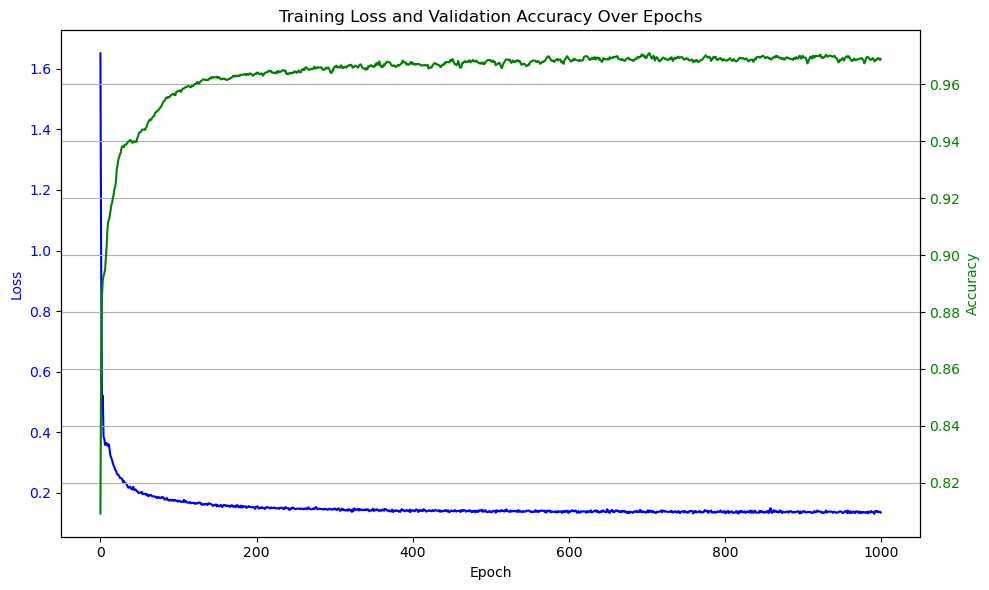

In [30]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [31]:
test_acc = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}')

Test Accuracy: 0.9428


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_36991/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


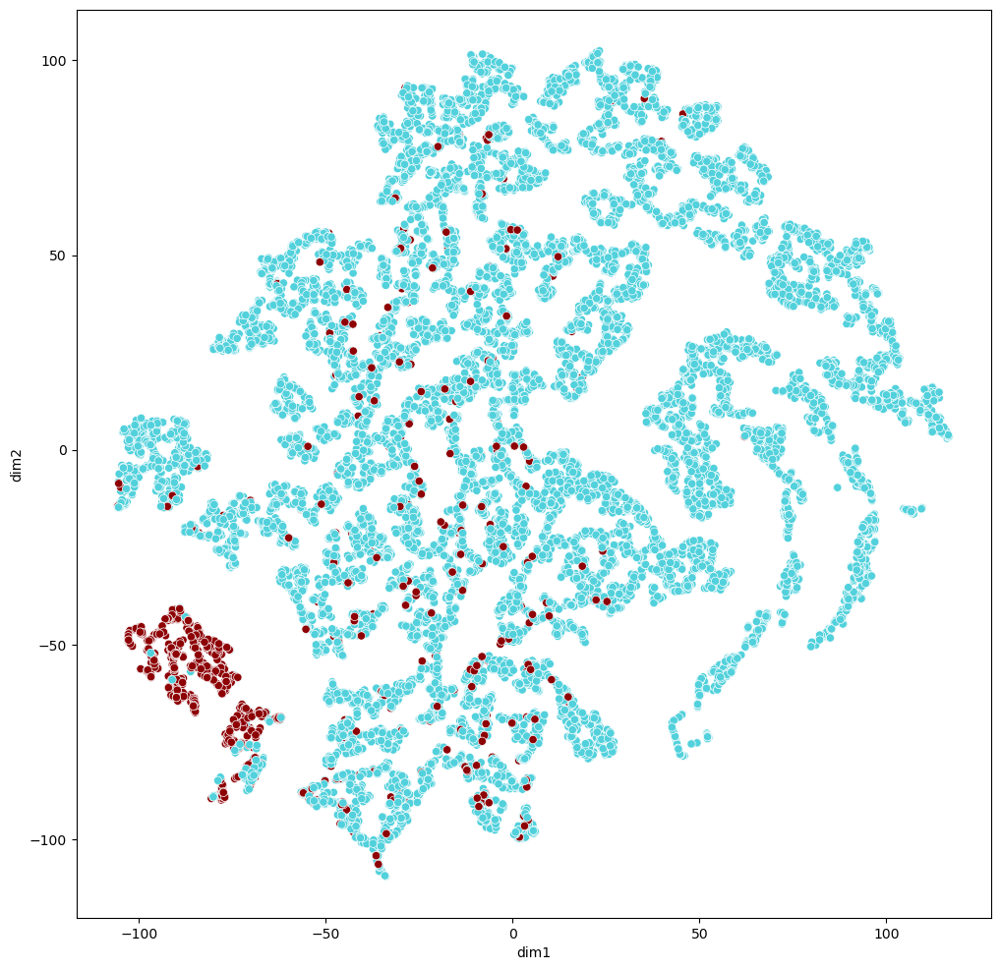

In [32]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)